In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
navoneel_brain_mri_images_for_brain_tumor_detection_path = kagglehub.dataset_download('bhaveshmittal/melanoma-cancer-dataset')

print('Data source import complete.')


Using Colab cache for faster access to the 'melanoma-cancer-dataset' dataset.
Data source import complete.


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

#dataset loading

In [ ]:
import os
import pandas as pd
import numpy as np


from sklearn.utils import shuffle
from sklearn.preprocessing import OrdinalEncoder
from sklearn.model_selection import train_test_split

import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img

In [ ]:
OD = OrdinalEncoder(categories= [['Benign', 'Malignant']])
LABEL = ['Benign', 'Malignant']

In [ ]:
x_train = pd.read_csv('/content/melanoma-cancer-dataset_x_train.csv')
y_train = pd.read_csv('/content/melanoma-cancer-dataset_y_train.csv')

x_val = pd.read_csv('/content/melanoma-cancer-dataset_x_val.csv')
y_val = pd.read_csv('/content/melanoma-cancer-dataset_y_val.csv')

x_test = pd.read_csv('/content/melanoma-cancer-dataset_x_test.csv')
y_test = pd.read_csv('/content/melanoma-cancer-dataset_y_test.csv')

In [ ]:
x_train = x_train.reset_index(drop=True)
y_train = y_train.reset_index(drop=True)


x_val = x_val.reset_index(drop=True)
y_val = y_val.reset_index(drop=True)

x_test = x_test.reset_index(drop=True)
y_test = y_test.reset_index(drop=True)

In [ ]:
print(y_train.value_counts())
needed = 3418 - 1266
print('___________')
print(needed)

label    
Benign       5831
Malignant    1600
Name: count, dtype: int64
___________
2152


In [ ]:
def images_show(index_list, x, y):
    x_col = x.iloc[:, 0] if hasattr(x, "iloc") else x
    y_col = y.iloc[:, 0] if hasattr(y, "iloc") else y

    images = []
    for idx in index_list:
        img_path = x_col.iloc[idx] if hasattr(x_col, "iloc") else x_col[idx]
        image = load_img(img_path, target_size=(150,150))
        images.append(image)

    plt.figure(figsize=(60, 45))
    for j, im in enumerate(images):
        idx = index_list[j]
        label = y_col.iloc[idx] if hasattr(y_col, "iloc") else y_col[idx]
        plt.subplot(5, 5, j+1)
        plt.imshow(im)
        plt.title(f"{idx} : {label}", fontsize=60)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


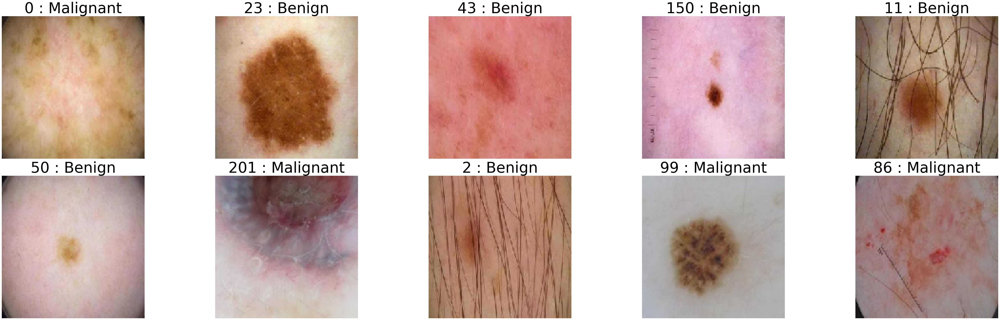

In [ ]:
# showing a sample from x_train ,any number between 0 - 201
images_show(index_list=[0, 23, 43, 150,
            11, 50,  201, 2, 99, 86], x=x_train, y=y_train)

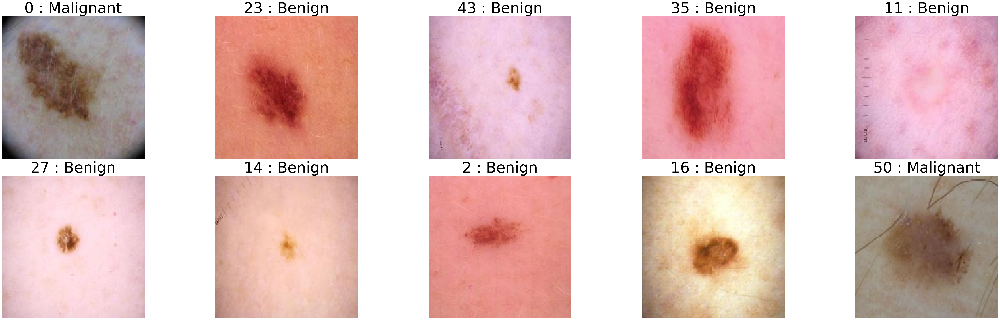

In [ ]:
# showing a sample from x_test ,any number between 0 - 50
images_show(index_list=[0, 23, 43, 35,
            11, 27,  14, 2, 16, 50], x=x_test, y=y_test)

In [ ]:
import numpy as np
import os
from tensorflow.keras.utils import load_img, img_to_array

def Array_con(df, target_size=(128, 128)):
    paths = df["path"].astype(str).tolist()

    arr = []
    missing = []
    for p in paths:
        if not os.path.exists(p):
            missing.append(p)
            continue
        img = load_img(p, target_size=target_size)
        arr.append(img_to_array(img))

    if len(arr) == 0:
        print("Example missing path:", missing[0] if missing else "None")
        raise ValueError("No images loaded. Your paths don't exist in this runtime.")

    print(f"Loaded {len(arr)} images, skipped {len(missing)} missing.")
    return np.array(arr, dtype=np.float32)


In [ ]:
x_train = Array_con(x_train)
x_val = Array_con(x_val)
x_test = Array_con(x_test)

Loaded 7431 images, skipped 0 missing.
Loaded 4644 images, skipped 0 missing.
Loaded 4645 images, skipped 0 missing.


In [ ]:
x_train.shape

(7431, 128, 128, 3)

In [ ]:
x_train = x_train / 255
x_test = x_test / 255

In [ ]:
y_test

,label
0,Malignant
1,Benign
2,Benign
3,Malignant
4,Benign
...,...
4640,Benign
4641,Benign
4642,Benign
4643,Benign


In [ ]:
# applying "OD"

y_train = np.array(y_train).reshape(-1,1)
y_test = np.array(y_test).reshape(-1,1)


y_train = OD.fit_transform(y_train)
y_test = OD.transform(y_test)

# WGAN

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt

tf.random.set_seed(42)
np.random.seed(42)

print("TF:", tf.__version__)


TF: 2.19.0


In [ ]:
MINORITY_LABEL = 1  # change if your minority class label is different

y_flat = np.squeeze(y_train)
X_minority = x_train[y_flat == MINORITY_LABEL].astype("float32")

print("Minority samples:", X_minority.shape)

# --- Ensure size is 128x128 ---
# If your images are already 128x128, this does nothing harmful.
X_minority = tf.image.resize(X_minority, (128, 128)).numpy().astype("float32")

# --- Scale to [-1, 1] (for tanh generator) ---
if X_minority.max() > 1.5:        # likely [0..255]
    X_minority = X_minority / 255.0

X_minority = (X_minority * 2.0) - 1.0
print("Min/Max after scaling:", X_minority.min(), X_minority.max())


Minority samples: (1600, 128, 128, 3)
Min/Max after scaling: -1.0 1.0


In [ ]:
BATCH_SIZE = 16

dataset = (
    tf.data.Dataset.from_tensor_slices(X_minority)
    .shuffle(min(4000, len(X_minority)))
    .batch(BATCH_SIZE, drop_remainder=True)
    .prefetch(tf.data.AUTOTUNE)
)


In [ ]:
def build_generator(latent_dim=128):
    z = layers.Input(shape=(latent_dim,))

    x = layers.Dense(8 * 8 * 512, use_bias=False)(z)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Reshape((8, 8, 512))(x)

    # 8 -> 16
    x = layers.Conv2DTranspose(256, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # 16 -> 32
    x = layers.Conv2DTranspose(128, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # 32 -> 64
    x = layers.Conv2DTranspose(64, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # 64 -> 128
    x = layers.Conv2DTranspose(32, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    out = layers.Conv2D(3, 3, padding="same", activation="tanh")(x)  # [-1,1]
    return tf.keras.Model(z, out, name="Generator")


In [ ]:
def build_critic(img_shape=(128, 128, 3)):
    img = layers.Input(shape=img_shape)

    x = layers.Conv2D(64, 4, strides=2, padding="same")(img)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(128, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(256, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(512, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(1024, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Flatten()(x)
    out = layers.Dense(1)(x)  # critic score (no sigmoid!)
    return tf.keras.Model(img, out, name="Critic")


In [ ]:
LATENT_DIM = 128

generator = build_generator(LATENT_DIM)
critic = build_critic((128, 128, 3))

z = tf.random.normal([2, LATENT_DIM])
fake = generator(z, training=False)
print("G output:", fake.shape)

score = critic(fake, training=False)
print("Critic output:", score.shape)


G output: (2, 128, 128, 3)
Critic output: (2, 1)


In [ ]:
def critic_loss(real_score, fake_score):
    # WGAN: maximize (real - fake) => minimize (fake - real)
    return tf.reduce_mean(fake_score) - tf.reduce_mean(real_score)

def generator_loss(fake_score):
    # WGAN: maximize fake_score => minimize -fake_score
    return -tf.reduce_mean(fake_score)

def gradient_penalty(critic, real, fake):
    batch_size = tf.shape(real)[0]
    alpha = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
    interpolated = real * alpha + fake * (1.0 - alpha)

    with tf.GradientTape() as tape:
        tape.watch(interpolated)
        pred = critic(interpolated, training=True)

    grads = tape.gradient(pred, interpolated)
    grads = tf.reshape(grads, [batch_size, -1])
    gp = tf.reduce_mean((tf.norm(grads, axis=1) - 1.0) ** 2)
    return gp


In [ ]:
LR = 5e-5
N_CRITIC = 3
LAMBDA_GP = 15.0

g_opt = tf.keras.optimizers.Adam(LR, beta_1=0.0, beta_2=0.9)
c_opt = tf.keras.optimizers.Adam(LR, beta_1=0.0, beta_2=0.9)

@tf.function
def train_step(real_imgs):
    batch_size = tf.shape(real_imgs)[0]

    # ---- Train critic N_CRITIC times ----
    for _ in tf.range(N_CRITIC):
        z = tf.random.normal([batch_size, LATENT_DIM])

        with tf.GradientTape() as tape:
            fake_imgs = generator(z, training=True)

            real_score = critic(real_imgs, training=True)
            fake_score = critic(fake_imgs, training=True)

            c_loss = critic_loss(real_score, fake_score)
            gp = gradient_penalty(critic, real_imgs, fake_imgs)
            c_total = c_loss + LAMBDA_GP * gp

        c_grads = tape.gradient(c_total, critic.trainable_variables)
        c_opt.apply_gradients(zip(c_grads, critic.trainable_variables))

    # ---- Train generator 1 time ----
    z = tf.random.normal([batch_size, LATENT_DIM])
    with tf.GradientTape() as tape:
        fake_imgs = generator(z, training=True)
        fake_score = critic(fake_imgs, training=True)
        g_loss = generator_loss(fake_score)

    g_grads = tape.gradient(g_loss, generator.trainable_variables)
    g_opt.apply_gradients(zip(g_grads, generator.trainable_variables))

    return g_loss, c_total


In [ ]:
def show_samples(epoch, n=16):
    z = tf.random.normal([n, LATENT_DIM])
    fake = generator(z, training=False).numpy()  # [-1,1]
    fake = (fake + 1.0) / 2.0                    # -> [0,1]

    cols = int(np.sqrt(n))
    rows = int(np.ceil(n / cols))
    plt.figure(figsize=(cols*2.2, rows*2.2))

    for i in range(n):
        plt.subplot(rows, cols, i+1)
        plt.imshow(np.clip(fake[i], 0, 1))
        plt.axis("off")

    plt.suptitle(f"Epoch {epoch}")
    plt.tight_layout()
    plt.show()


Epoch 001/80 | G=221.5660 | C_total=-271.1549
Epoch 002/80 | G=119.0671 | C_total=-164.3512
Epoch 003/80 | G=71.4768 | C_total=-63.5687
Epoch 004/80 | G=66.4282 | C_total=-59.7536
Epoch 005/80 | G=46.1075 | C_total=-53.0271


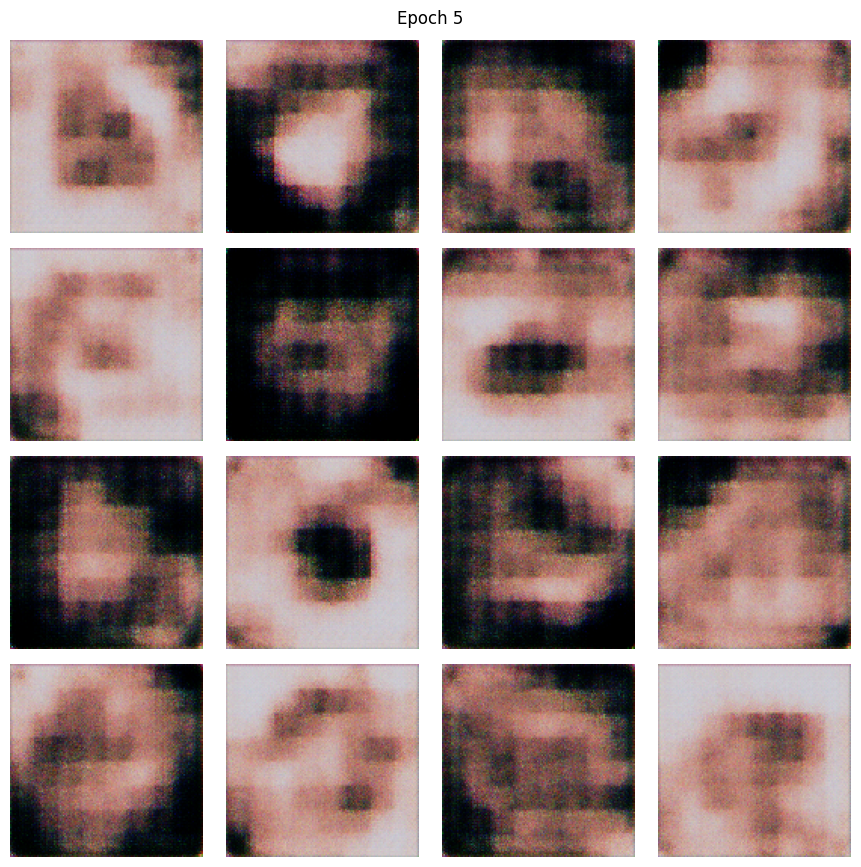

Epoch 006/80 | G=28.3833 | C_total=-45.4739
Epoch 007/80 | G=9.4015 | C_total=-47.6177
Epoch 008/80 | G=-23.3402 | C_total=-47.3729
Epoch 009/80 | G=-35.6533 | C_total=-47.0969
Epoch 010/80 | G=-40.3738 | C_total=-50.0716


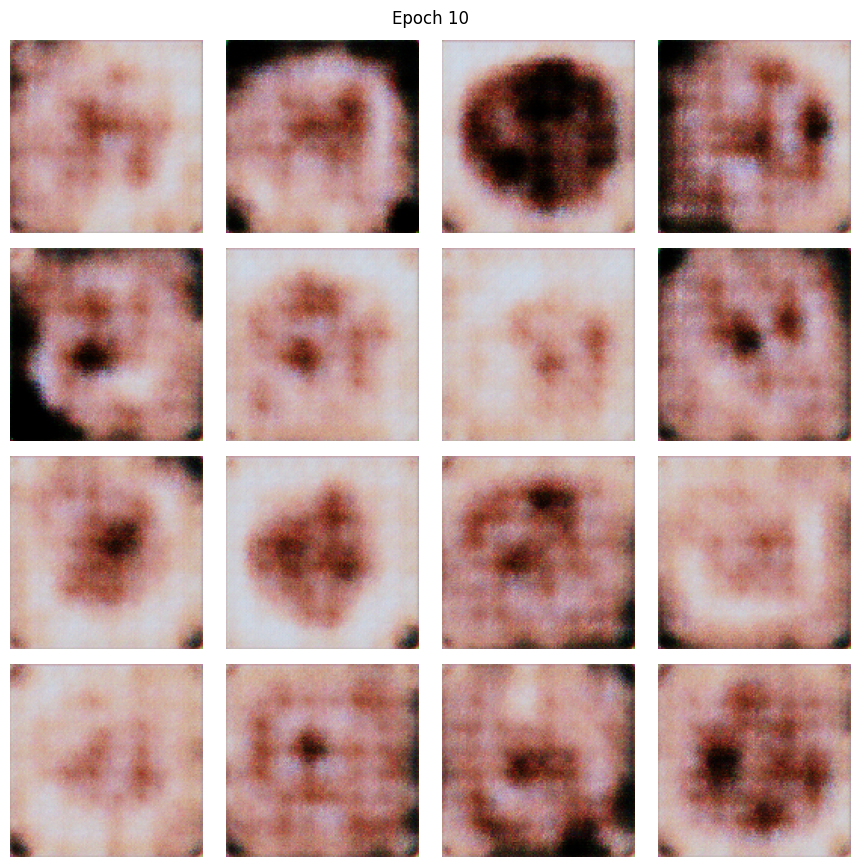

Epoch 011/80 | G=-54.5245 | C_total=-47.8080
Epoch 012/80 | G=-35.4468 | C_total=-42.6018
Epoch 013/80 | G=-50.0267 | C_total=-42.3896
Epoch 014/80 | G=-62.3091 | C_total=-39.6622
Epoch 015/80 | G=-78.6929 | C_total=-36.8638


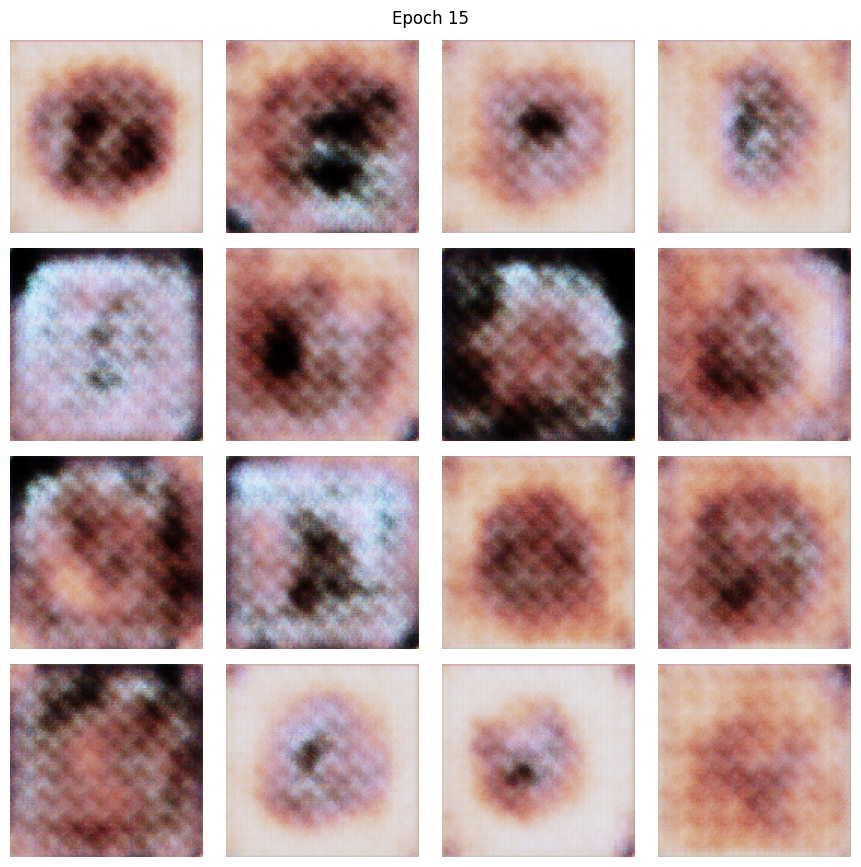

Epoch 016/80 | G=-74.2500 | C_total=-36.1969
Epoch 017/80 | G=-89.6266 | C_total=-34.4624
Epoch 018/80 | G=-94.8940 | C_total=-30.7975
Epoch 019/80 | G=-84.1330 | C_total=-30.2878
Epoch 020/80 | G=-95.3330 | C_total=-29.3346


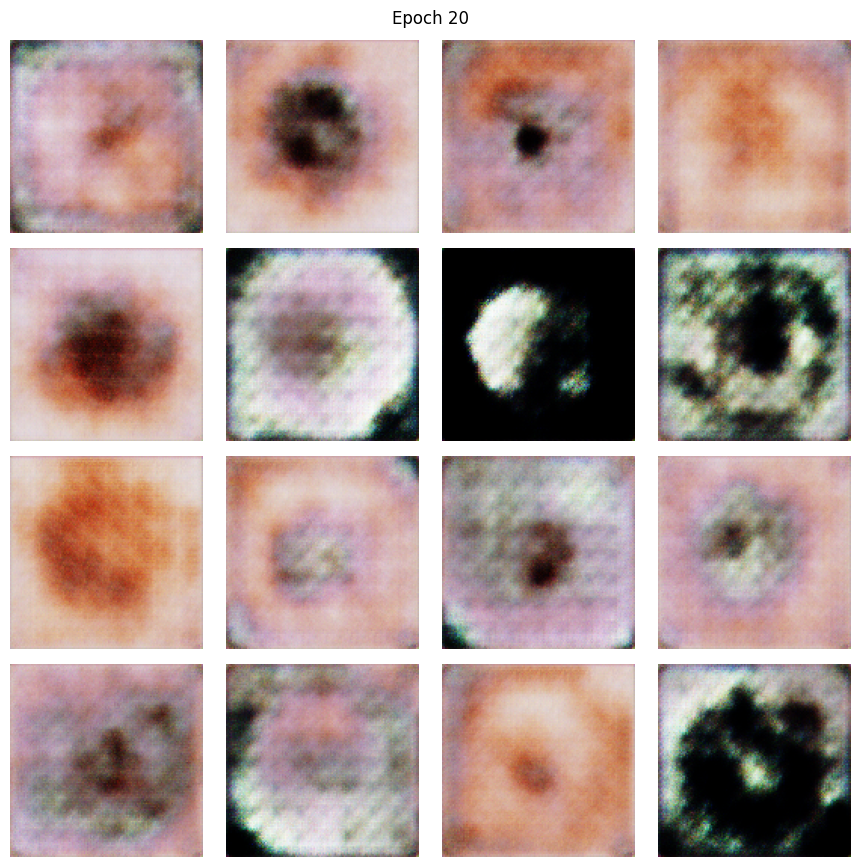

Epoch 021/80 | G=-87.0640 | C_total=-28.3809
Epoch 022/80 | G=-79.3034 | C_total=-27.1368
Epoch 023/80 | G=-77.2875 | C_total=-28.0341
Epoch 024/80 | G=-73.5346 | C_total=-27.1815
Epoch 025/80 | G=-74.9236 | C_total=-26.3013


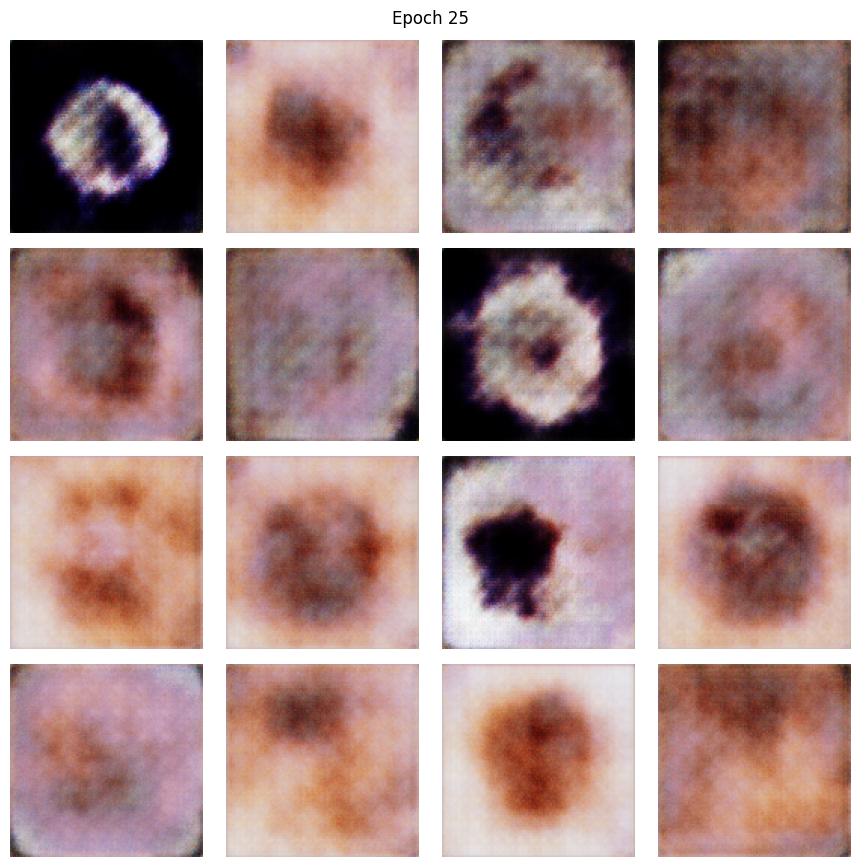

Epoch 026/80 | G=-57.4458 | C_total=-25.4604
Epoch 027/80 | G=-59.5214 | C_total=-24.9928
Epoch 028/80 | G=-62.1720 | C_total=-26.4642
Epoch 029/80 | G=-58.0047 | C_total=-27.3295
Epoch 030/80 | G=-55.5470 | C_total=-24.8183


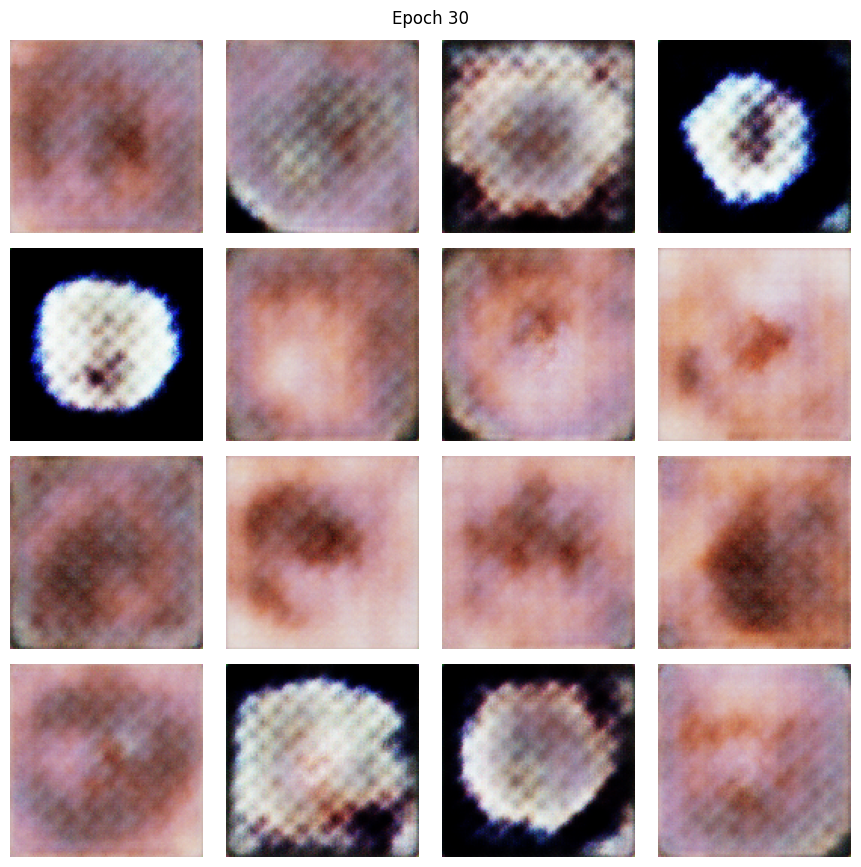

Epoch 031/80 | G=-44.7485 | C_total=-24.3590
Epoch 032/80 | G=-18.3233 | C_total=-23.9105
Epoch 033/80 | G=-44.6527 | C_total=-22.5971
Epoch 034/80 | G=-45.0223 | C_total=-23.8783
Epoch 035/80 | G=-26.6206 | C_total=-21.1009


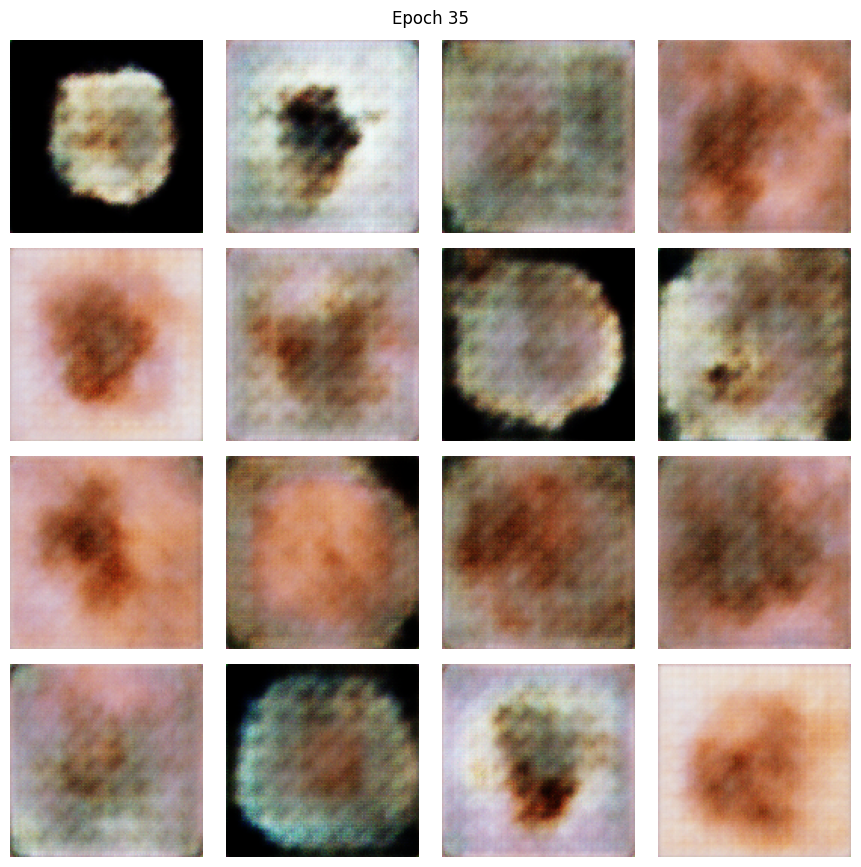

Epoch 036/80 | G=-34.3969 | C_total=-21.7982
Epoch 037/80 | G=-39.9324 | C_total=-20.6098
Epoch 038/80 | G=-32.7958 | C_total=-22.8852
Epoch 039/80 | G=-45.4217 | C_total=-20.3575
Epoch 040/80 | G=-33.0254 | C_total=-19.5299


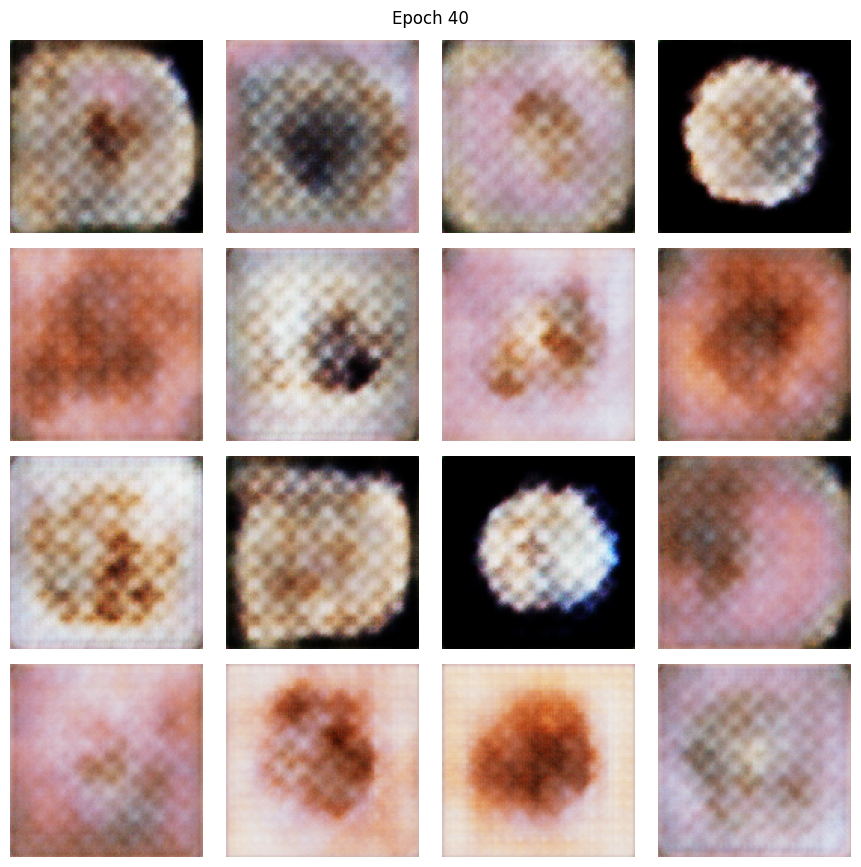

Epoch 041/80 | G=-30.4233 | C_total=-21.0548
Epoch 042/80 | G=-43.0181 | C_total=-20.0652
Epoch 043/80 | G=-12.8073 | C_total=-19.6250
Epoch 044/80 | G=-14.3780 | C_total=-18.7007
Epoch 045/80 | G=-24.4501 | C_total=-20.6516


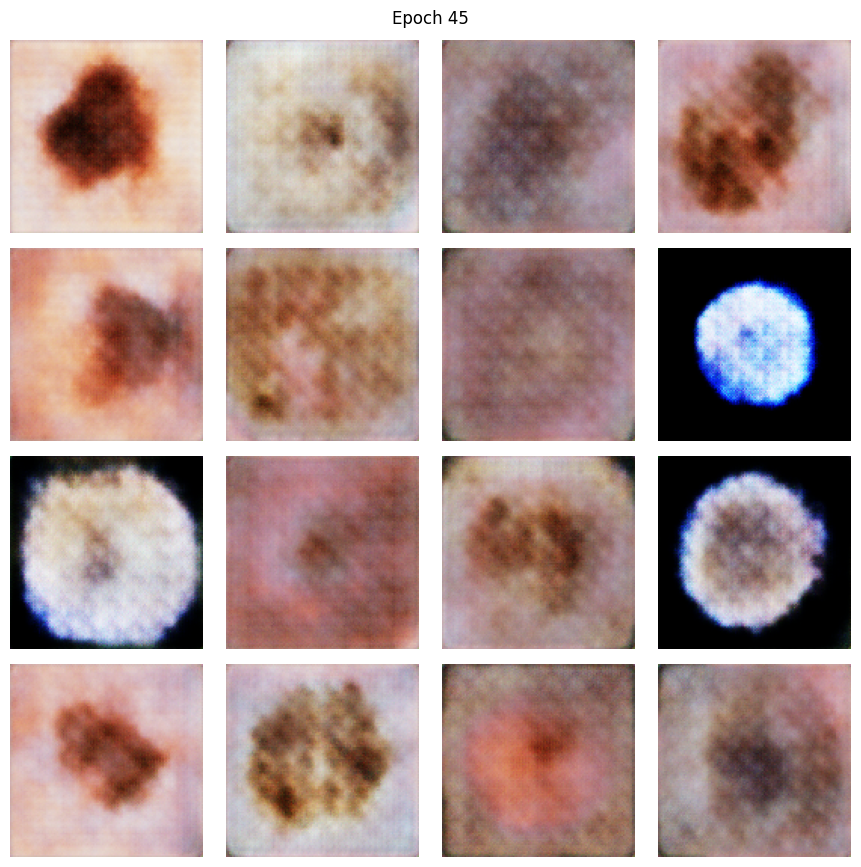

Epoch 046/80 | G=-21.3565 | C_total=-18.1338
Epoch 047/80 | G=-24.5667 | C_total=-19.7823
Epoch 048/80 | G=-31.6460 | C_total=-21.2899
Epoch 049/80 | G=-37.8555 | C_total=-17.8284
Epoch 050/80 | G=-35.8300 | C_total=-18.7377


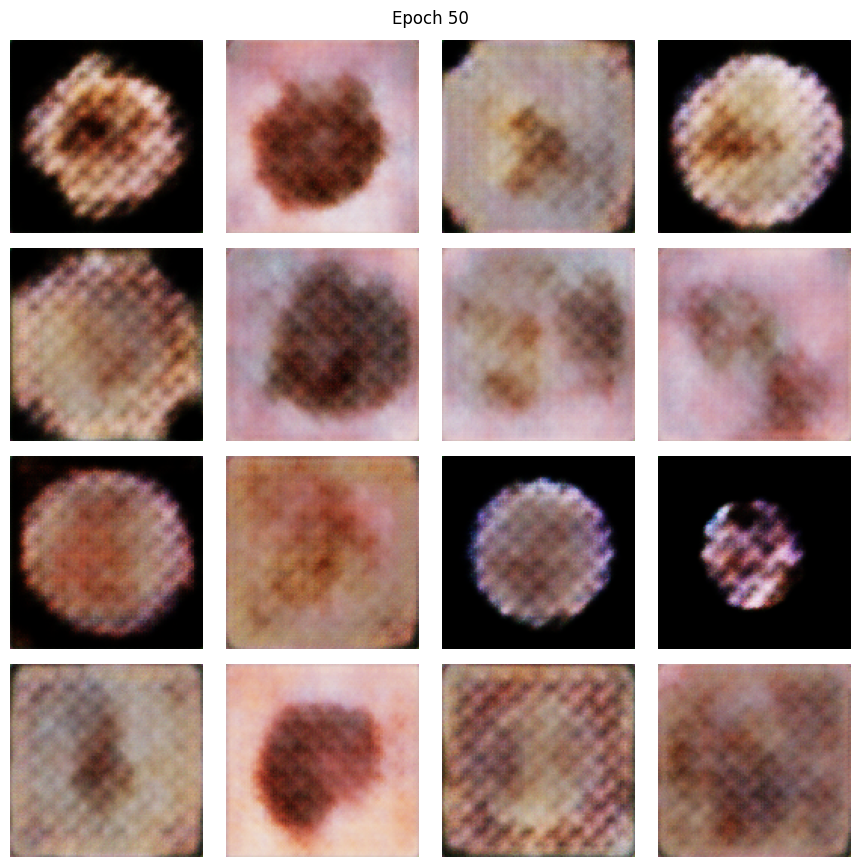

Epoch 051/80 | G=-42.9365 | C_total=-18.2756
Epoch 052/80 | G=-42.2101 | C_total=-16.9702
Epoch 053/80 | G=-30.2836 | C_total=-17.2892
Epoch 054/80 | G=-33.5616 | C_total=-16.8482
Epoch 055/80 | G=-26.2553 | C_total=-17.2664


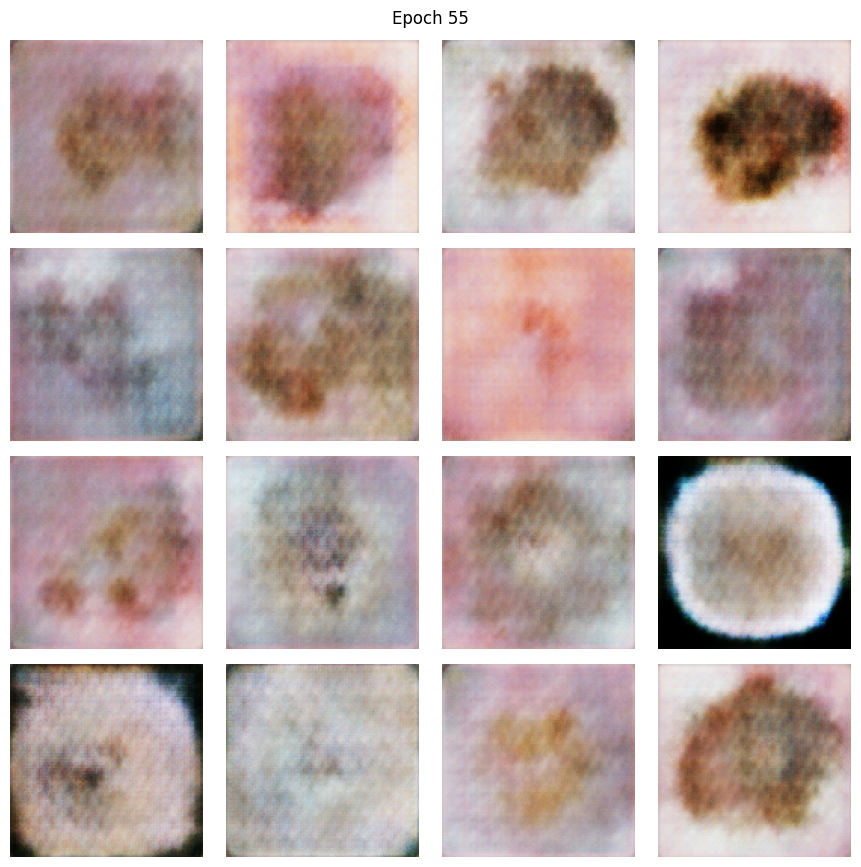

Epoch 056/80 | G=-35.1445 | C_total=-17.9270
Epoch 057/80 | G=-44.5527 | C_total=-16.3589
Epoch 058/80 | G=-30.9087 | C_total=-18.4279
Epoch 059/80 | G=-52.9658 | C_total=-17.2051
Epoch 060/80 | G=-43.1137 | C_total=-18.5084


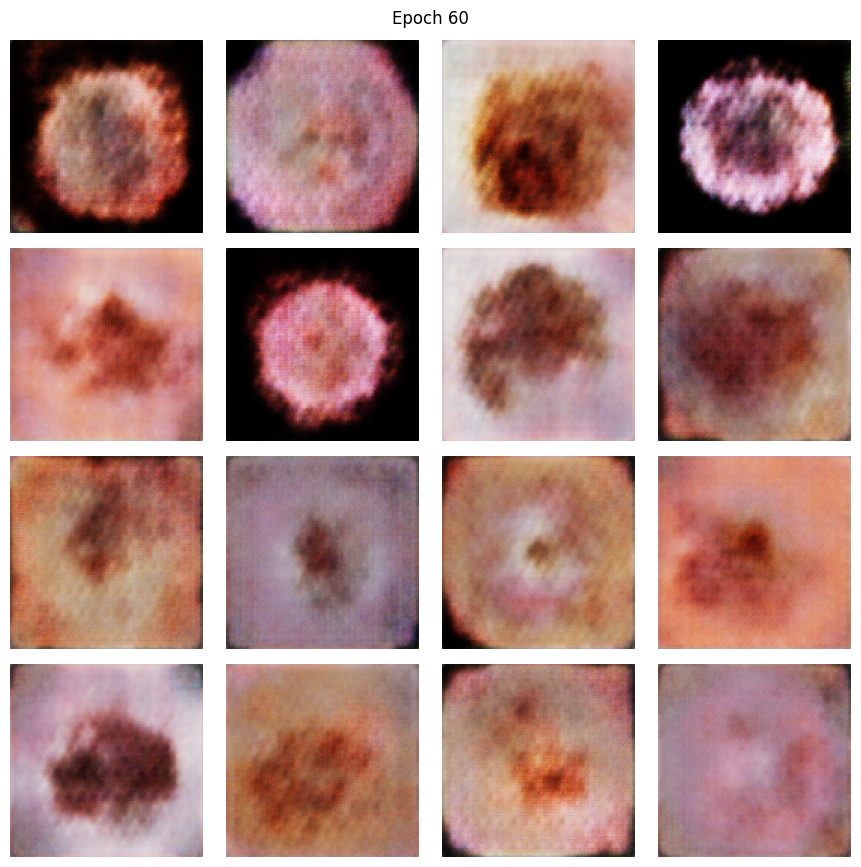

Epoch 061/80 | G=-47.6871 | C_total=-17.2946
Epoch 062/80 | G=-38.8005 | C_total=-15.6942
Epoch 063/80 | G=-63.4671 | C_total=-14.8526
Epoch 064/80 | G=-46.3306 | C_total=-15.3304
Epoch 065/80 | G=-34.7642 | C_total=-15.2353


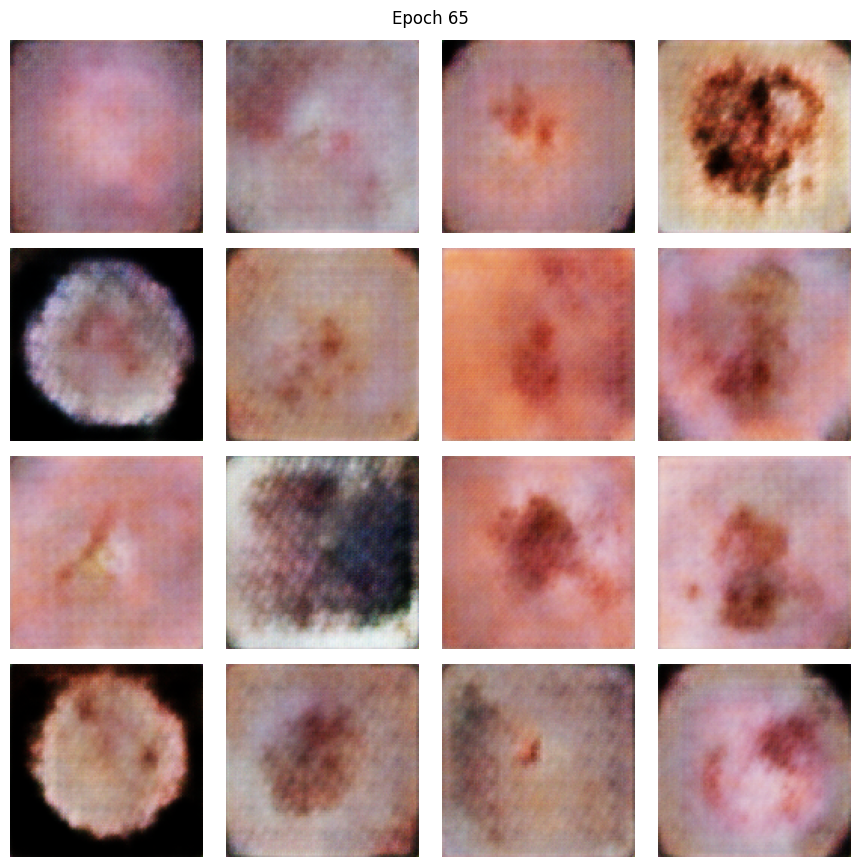

Epoch 066/80 | G=-33.6760 | C_total=-14.6876
Epoch 067/80 | G=-38.9673 | C_total=-14.6791
Epoch 068/80 | G=-41.5087 | C_total=-15.9097
Epoch 069/80 | G=-12.6697 | C_total=-15.9582
Epoch 070/80 | G=-45.3924 | C_total=-15.4483


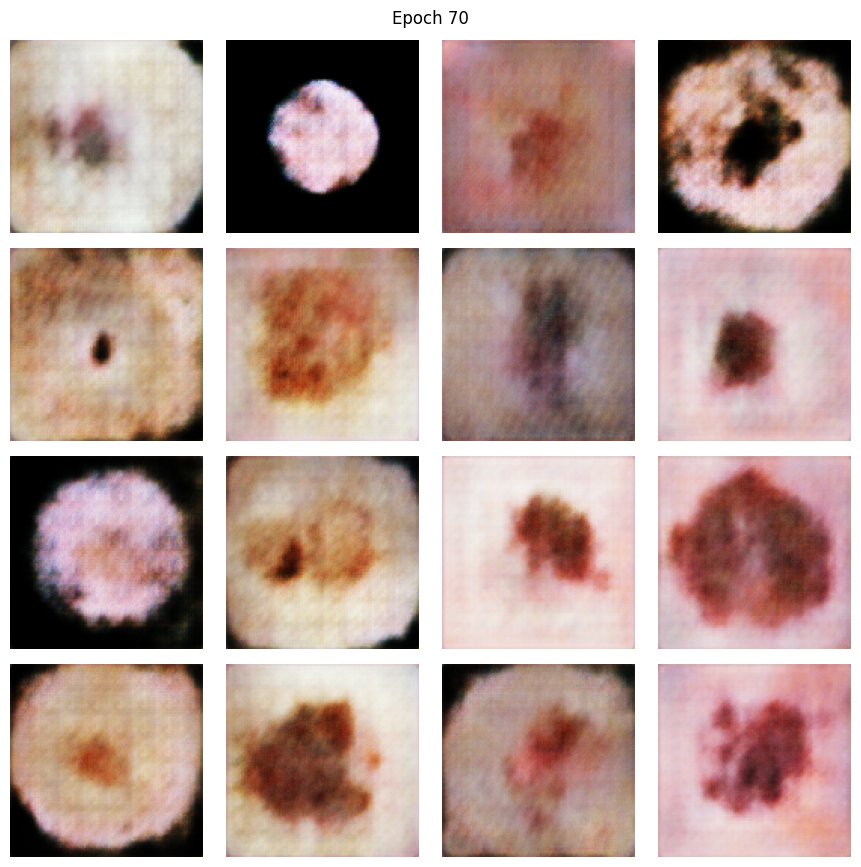

Epoch 071/80 | G=-33.8802 | C_total=-16.1012
Epoch 072/80 | G=-39.7391 | C_total=-17.2467
Epoch 073/80 | G=-37.6316 | C_total=-16.4134
Epoch 074/80 | G=-25.8760 | C_total=-15.5679
Epoch 075/80 | G=-32.3483 | C_total=-16.2193


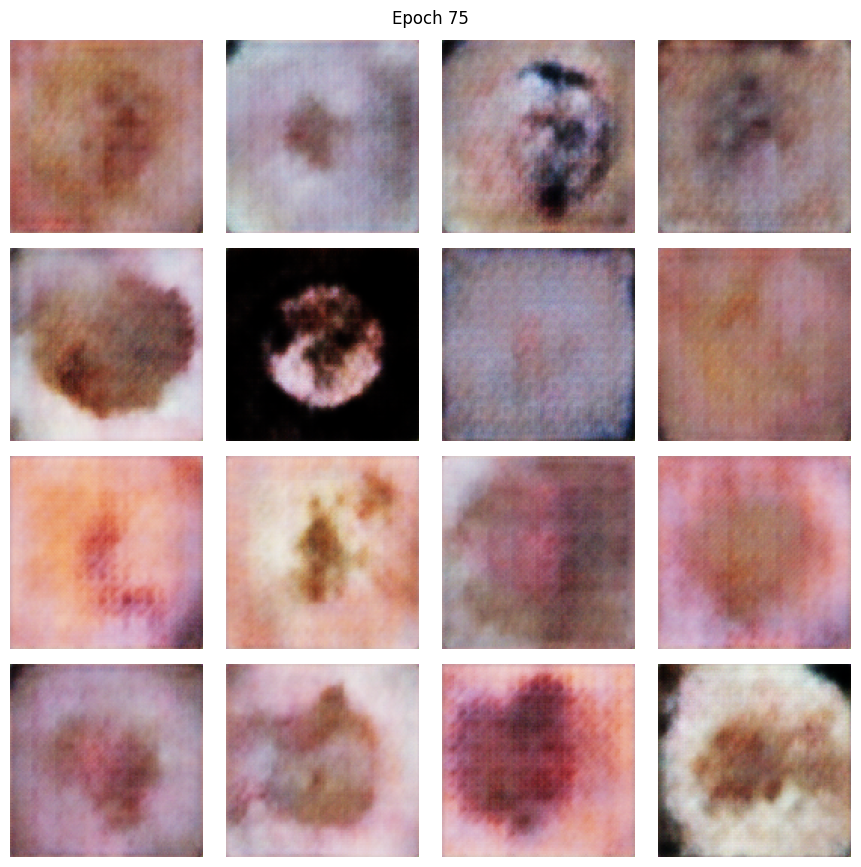

Epoch 076/80 | G=-33.1844 | C_total=-14.3625
Epoch 077/80 | G=-35.8753 | C_total=-13.7813
Epoch 078/80 | G=-44.4928 | C_total=-16.5837
Epoch 079/80 | G=-62.6846 | C_total=-15.3727
Epoch 080/80 | G=-42.1770 | C_total=-16.2636


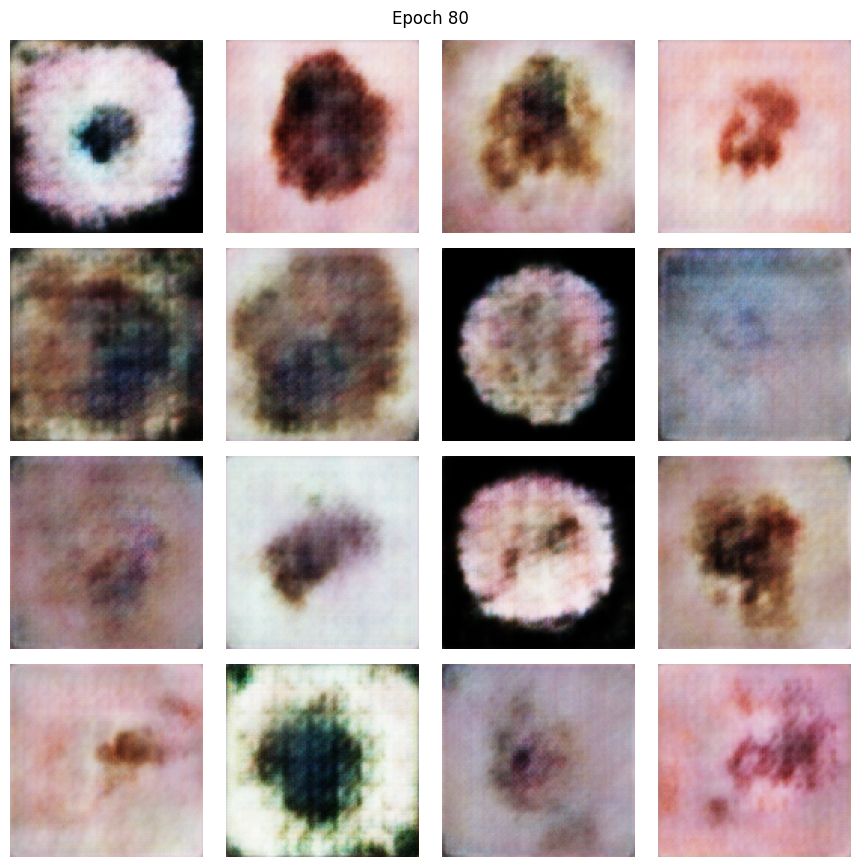

In [ ]:
EPOCHS = 80

history_g = []
history_c = []

for epoch in range(1, EPOCHS + 1):
    g_losses = []
    c_losses = []

    for real_batch in dataset:
        g_loss, c_loss = train_step(real_batch)
        g_losses.append(float(g_loss))
        c_losses.append(float(c_loss))

    g_mean = np.mean(g_losses)
    c_mean = np.mean(c_losses)
    history_g.append(g_mean)
    history_c.append(c_mean)

    print(f"Epoch {epoch:03d}/{EPOCHS} | G={g_mean:.4f} | C_total={c_mean:.4f}")

    if epoch % 5 == 0:
        show_samples(epoch, n=16)


In [ ]:
generator.save_weights("generator_finetuned_minority.weights.h5")
critic.save_weights("critic_finetuned_minority.weights.h5")

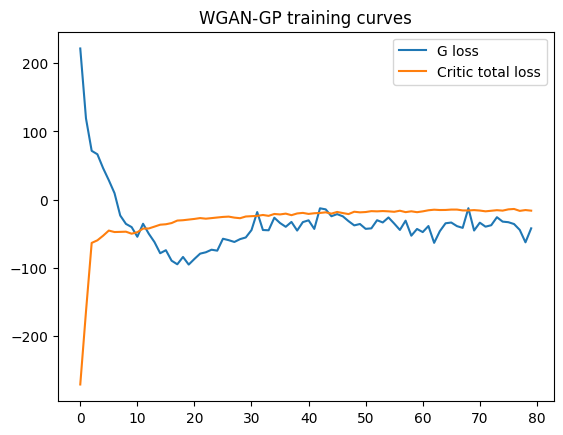

In [ ]:
plt.figure()
plt.plot(history_g, label="G loss")
plt.plot(history_c, label="Critic total loss")
plt.legend()
plt.title("WGAN-GP training curves")
plt.show()


In [ ]:
BATCH_SIZE = 8
LR = 5e-5
N_CRITIC = 5
LAMBDA_GP = 10.0
print(x_train.shape, y_train.shape, x_train.min(), x_train.max())


(7431, 128, 128, 3) (7431, 1) 0.0 1.0


## Generate new data

In [ ]:
import numpy as np
import tensorflow as tf

# labels
y_train_np = np.asarray(y_train).reshape(-1).astype(int)

counts = np.bincount(y_train_np)
minority = np.argmin(counts)
majority = np.argmax(counts)
need = counts[majority] - counts[minority]
print("Minority class:", minority, "| Need synthetic:", need)

# real images
X_real = np.asarray(x_train).astype(np.float32)

# 1) resize real images to 128 to match generator output
if X_real.shape[1] != 128:
    X_real = tf.image.resize(X_real, (128, 128)).numpy().astype(np.float32)

# 2) ensure real is [0,1] for classifier
if X_real.max() > 1.5:   # likely [0..255]
    X_real = X_real / 255.0
X_real = np.clip(X_real, 0.0, 1.0)

def generate_in_batches(generator, n, latent_dim, batch_size=16):
    outs = []
    for i in range(0, n, batch_size):
        bs = min(batch_size, n - i)
        z = tf.random.normal((bs, latent_dim))
        x = generator(z, training=False).numpy().astype(np.float32)  # [-1,1]
        outs.append(x)
    return np.concatenate(outs, axis=0)

if need > 0:
    X_syn = generate_in_batches(generator, need, LATENT_DIM, batch_size=16)  # [-1,1]
    X_syn = (X_syn + 1.0) / 2.0   # -> [0,1] for classifier
    X_syn = np.clip(X_syn, 0.0, 1.0)

    x_train_bal = np.concatenate([X_real, X_syn], axis=0)
    y_train_bal = np.concatenate([y_train_np, np.full(need, minority, dtype=int)], axis=0)
else:
    x_train_bal = X_real
    y_train_bal = y_train_np

print("Balanced train counts:", np.bincount(y_train_bal))
print("x_train_bal shape:", x_train_bal.shape, "range:", x_train_bal.min(), x_train_bal.max())


Minority class: 1 | Need synthetic: 4231
Balanced train counts: [5831 5831]
x_train_bal shape: (11662, 128, 128, 3) range: 0.0 1.0


## Evaluating vanilla GAN

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam , SGD, AdamW, Adadelta
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.metrics import BinaryAccuracy

from tensorflow.keras.callbacks import EarlyStopping


from tensorflow.keras.regularizers import l2
import keras
from keras import ops

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - binary_accuracy: 0.6199 - loss: 0.6279 - val_binary_accuracy: 0.8329 - val_loss: 0.3766
Epoch 2/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - binary_accuracy: 0.8225 - loss: 0.3963 - val_binary_accuracy: 0.8422 - val_loss: 0.3615
Epoch 3/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - binary_accuracy: 0.8478 - loss: 0.3479 - val_binary_accuracy: 0.8620 - val_loss: 0.3210
Epoch 4/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - binary_accuracy: 0.8700 - loss: 0.3025 - val_binary_accuracy: 0.8719 - val_loss: 0.3011
Epoch 5/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - binary_accuracy: 0.8929 - loss: 0.2665 - val_binary_accuracy: 0.8855 - val_loss: 0.2800
Epoch 6/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - binary_accuracy: 0.9055 - loss: 0.2415 - val_binary_accuracy: 0.8868 - val_loss: 0.2707
Epoch 7/80
584/584 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - binary_accuracy: 0.9130 - loss: 0.2236 - val_binary_accuracy: 0.8904 - val_loss: 0.2605
Epoc

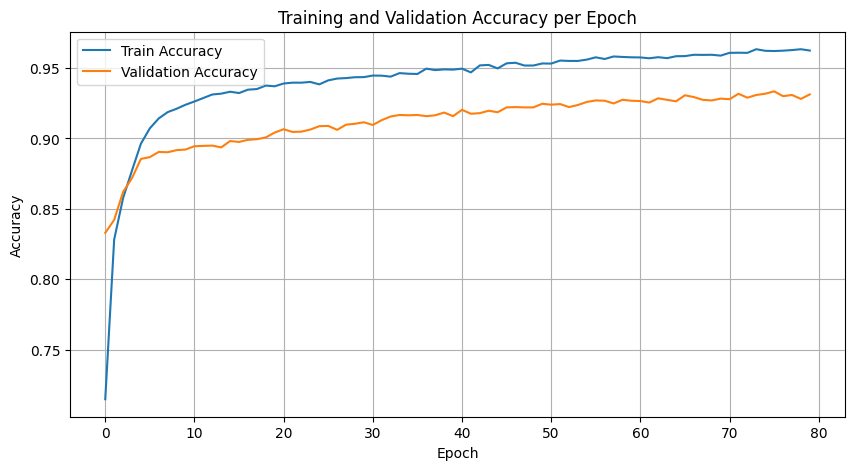

146/146 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step

Classification Report:
              precision    recall  f1-score   support

         0.0       0.94      0.97      0.96      3645
         1.0       0.89      0.78      0.83      1000

    accuracy                           0.93      4645
   macro avg       0.91      0.88      0.89      4645
weighted avg       0.93      0.93      0.93      4645


Confusion Matrix:


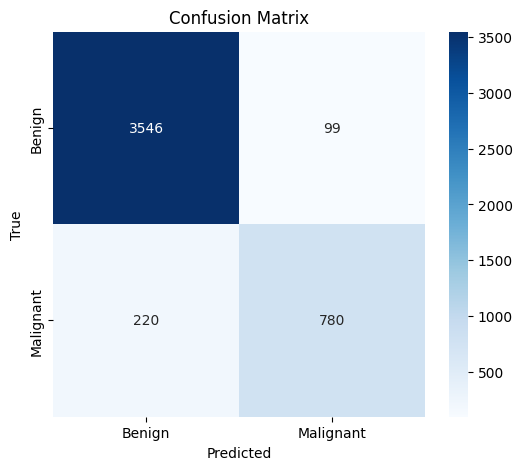

In [ ]:
model_cond_gan = tf.keras.Sequential([
    layers.Conv2D(16, (3, 3), strides=(1,1) ,activation='relu', input_shape=(128, 128, 3)),
    layers.MaxPool2D(),
    layers.Conv2D(4, (3, 3), strides=(1,1) , activation='relu'),

    layers.Conv2D(4, (3, 3), strides=(1,1) , activation='relu'),
    layers.AveragePooling2D((1,1)),

    layers.Flatten(),
    layers.Dropout(0.4),
    layers.Dense(1, activation='sigmoid')
])


model_cond_gan.compile(optimizer= Adam(learning_rate=0.0001),
              loss=BinaryCrossentropy(),
              metrics=[BinaryAccuracy()])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


history = model_cond_gan.fit(x_train_bal, y_train_bal,
                    epochs=80,
                    batch_size=20,
                    validation_data=(x_test, y_test),
                    callbacks=[early_stopping])


test_loss, test_accuracy = model_cond_gan.evaluate(x_test, y_test)
final_train_acc = history.history['binary_accuracy'][-1]

print(f"\nFinal Train Accuracy: {final_train_acc:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")



plt.figure(figsize=(10, 5))
plt.plot(history.history['binary_accuracy'], label='Train Accuracy')
plt.plot(history.history['val_binary_accuracy'], label='Validation Accuracy')

plt.title('Training and Validation Accuracy per Epoch')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()




# Predict on test data
y_prob = model_cond_gan.predict(x_test).ravel()      # probabilities in [0,1]
y_pred = (y_prob >= 0.5).astype(int)        # class 0/1


# Print classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Confusion matrix plot
print("\nConfusion Matrix:")
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=LABEL, yticklabels=LABEL)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()